## Testing data augmentation with a image

In [11]:
##코랩실행시 google driver mount 하기
from google.colab import drive
drive.mount('/content/drive')
% cd /content/drive/My Drive/FAS

Mounted at /content/drive
/content/drive/.shortcut-targets-by-id/1TqiLqH4tEiegE2VV31jEOqz8mpomLApP/FAS


In [5]:
! pip install SimpleITK
! pip install pydicom

     |████████████████████████████████| 44.9MB 99kB/s 
     |████████████████████████████████| 35.5MB 1.3MB/s 


In [22]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img
import pydicom as pdc
import matplotlib.pyplot as plt
import pandas as pd
import cv2
import numpy as np
from PIL import Image
import tensorflow as tf
import SimpleITK as sitk
import glob
from skimage import exposure

In [9]:
from numpy import expand_dims
from keras.preprocessing.image import img_to_array

In [13]:
path = './metadata/'
label_df = pd.read_csv('metadata/label_df.csv')
patient_meta = pd.read_csv(path + 'patient_meta.csv')
label_df.head()

,patient_no,img_idx,mean_annotation,DX
0,SN00017916,1,0.0,0
1,SN00017916,2,0.0,0
2,SN00017916,3,0.0,0
3,SN00017916,4,0.0,0
4,SN00017916,5,0.0,0


In [14]:
def make_image(data):
        try:
            if len(data.shape) == 2:
                # grayscale image, just add once channel
                data = data.reshape((data.shape[0], data.shape[1], 1))

            image = array_to_img(data)
        except Exception:
            return None

        # image = image.resize((128, 128))

        return image 

(128, 128, 1)
(1, 128, 128, 1)


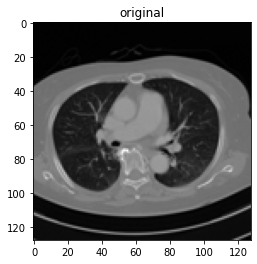

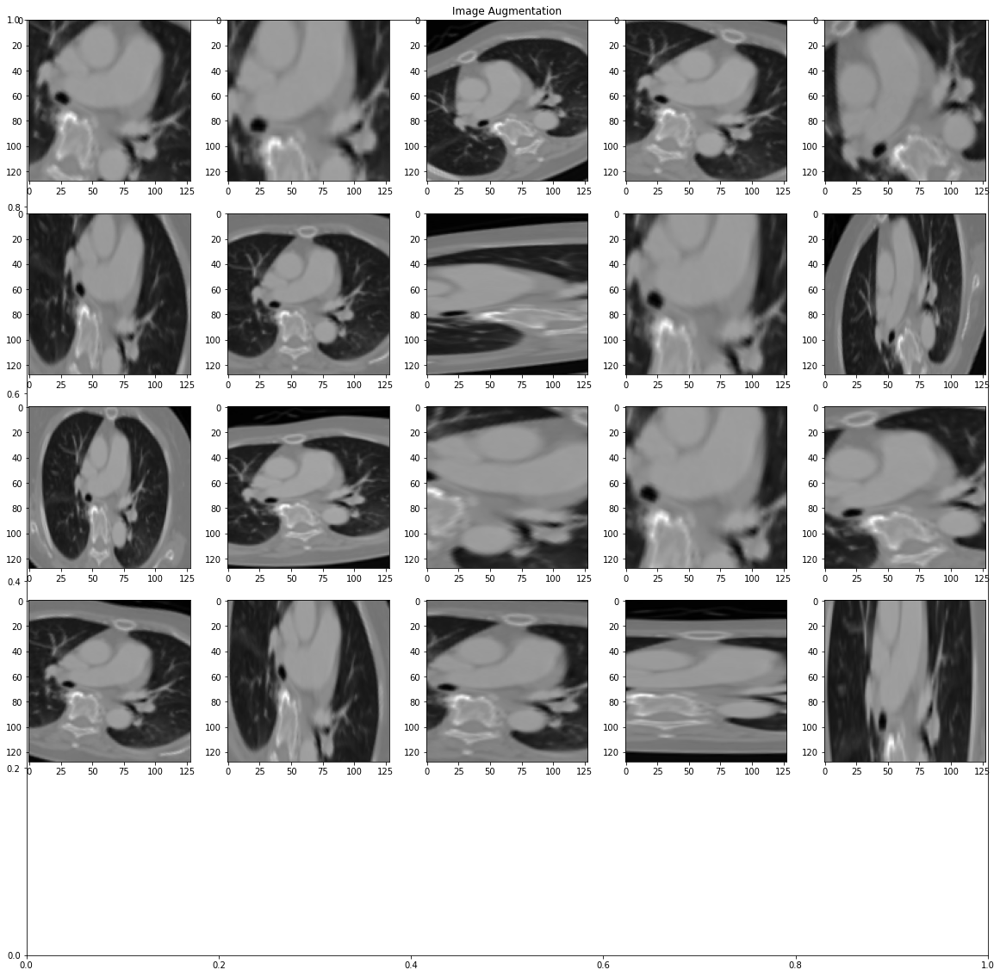

In [16]:
datagen = ImageDataGenerator(
        rotation_range=40,
#         width_shift_range=0.2,
#         height_shift_range=0.2,
        shear_range=0.2,
        zoom_range=[0.2,1.0],
        horizontal_flip=False,
        fill_mode='nearest')

path = './benchmark_liver_tumor/raw/SN00017916/SN00017916_0001.dcm'

sample = pdc.dcmread(path)
sample_np = sample.pixel_array
img = make_image(sample_np)
img=img.resize((128,128))
img_np = img_to_array(img)

# Display original img
plt.figure()
plt.title('original')
plt.imshow(img,cmap='gray')

print(img_np.shape)

x = img_np.reshape((1,) + img_np.shape)  
print(x.shape)

#dx_block = label_df.loc[label_df['patient_no']==patient_meta[tr_idx, 0],'DX']

i = 0
image_list = [img_np]
fig=plt.figure(figsize=(20,20))
plt.title('Image Augmentation')
for batch in datagen.flow(x, batch_size=1):
    if i > 19:
        break 
    i += 1
    fig.add_subplot(5, 5, i)
    plt.imshow(batch.reshape(128,128),cmap='gray')
    image_list.append(batch)
plt.show()

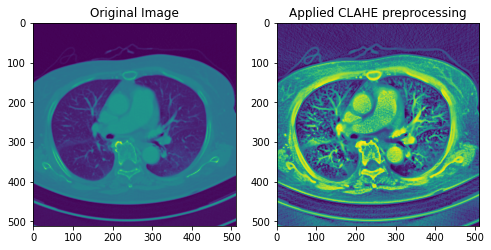

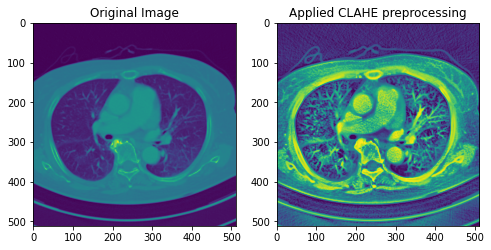

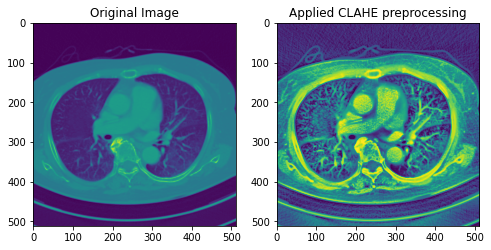

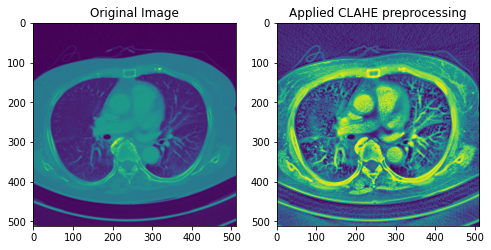

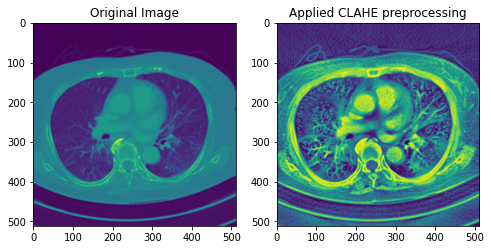

...

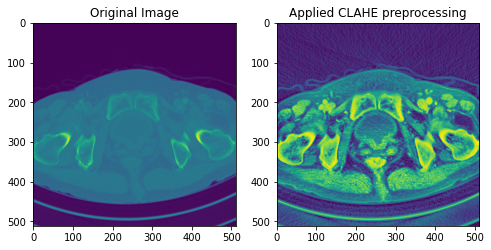

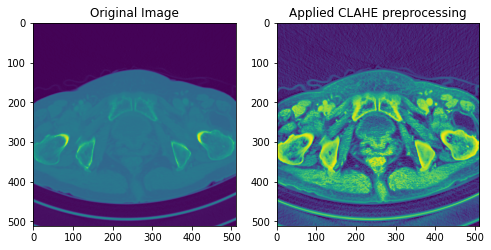

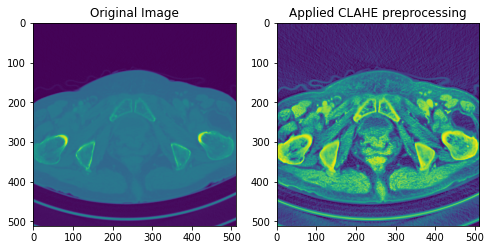

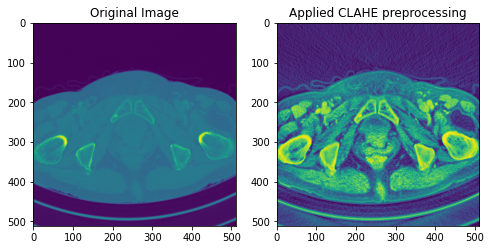

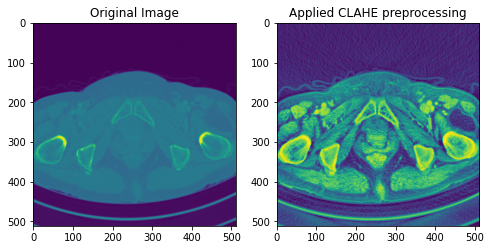

In [ ]:
file_path = './benchmark_liver_tumor/raw/'

X_i_tr_ct_list = sorted(glob.glob(file_path+'SN00017916'+'/*.dcm'))
#print(X_i_tr_ct_list)

for X in X_i_tr_ct_list:
  f, ax = plt.subplots(1,2, figsize=(8,6))

  sample = pdc.dcmread(X)
  sample_np = sample.pixel_array
  ax[0].set_title("Original Image")
  ax[0].imshow(sample_np)

  sample_np_exp=exposure.equalize_adapthist(sample_np,clip_limit=0.03,nbins=512)
  ax[1].set_title("Applied CLAHE preprocessing")
  ax[1].imshow(sample_np_exp)
  plt.show() 